In [1]:
!echo Y | sudo apt-get install python3-opencv


Reading package lists... Done
Building dependency tree       
Reading state information... Done
The following NEW packages will be installed:
  python3-opencv
0 upgraded, 1 newly installed, 0 to remove and 154 not upgraded.
Need to get 474 kB of archives.
After this operation, 2573 kB of additional disk space will be used.
Get:1 http://ports.ubuntu.com/ubuntu-ports bionic-updates/universe arm64 python3-opencv arm64 3.2.0+dfsg-4ubuntu0.1 [474 kB]
Fetched 474 kB in 2s (310 kB/s)         
perl: warning: Setting locale failed.
perl: warning: Please check that your locale settings:
	LANGUAGE = (unset),
	LC_ALL = (unset),
	LANG = "en_US.UTF-8"
    are supported and installed on your system.
perl: warning: Falling back to the standard locale ("C").
debconf: unable to initialize frontend: Dialog
debconf: (No usable dialog-like program is installed, so the dialog based frontend cannot be used. at /usr/share/perl5/Debconf/FrontEnd/Dialog.pm line 76, <> line 1.)
debconf: falling back to frontend:

In [2]:
!pip install paho-mqtt

     |################################| 102kB 673kB/s ta 0:00:01
  Created wheel for paho-mqtt: filename=paho_mqtt-1.5.0-cp36-none-any.whl size=74650 sha256=0095dbcae91749eed90b697343bf392fb51271473370c9a724700a4050c30031
  Stored in directory: /root/.cache/pip/wheels/02/94/6c/8474137cb7a5a3e001d70a22c8ff919caee69435376bccce79
Successfully built paho-mqtt
You should consider upgrading via the 'pip install --upgrade pip' command.


In [ ]:
!pip install python3-opencv

In [7]:
!pip install PIL

ERROR: Could not find a version that satisfies the requirement PIL (from versions: none)
ERROR: No matching distribution found for PIL
You should consider upgrading via the 'pip install --upgrade pip' command.


In [10]:
import numpy as np
import cv2
import io

In [ ]:
!pwd

In [29]:
import paho.mqtt.client as mqtt
import base64

In [41]:
import base64

with open("Andres.jpg", "rb") as image:
    b64string = base64.b64encode(image.read())
    
from PIL import Image
import io

f1 = io.BytesIO(base64.b64decode(b64string))
pilimage = Image.open(f1) 
pilimage.save("Andres6.jpg")
b64string

b'/9j/4QC5RXhpZgAASUkqAAgAAAAEABABAgATAAAAPgAAADEBAgAOAAAAUQAAADIBAgAUAAAAXwAAAGmHBAABAAAAcwAAAAAAAABIRCBQcm8gV2ViY2FtIEM5MjAAQ2hlZXNlIDMuMjguMAAyMDIwOjA3OjA5IDEyOjQ3OjIwAAMAAJAHAAQAAAAwMjMwA5ACABQAAACdAAAAAKAHAAQAAAAwMTAwAAAAADIwMjA6MDc6MDkgMTI6NDc6MjAA/+EL/2h0dHA6Ly9ucy5hZG9iZS5jb20veGFwLzEuMC8APD94cGFja2V0IGJlZ2luPSLvu78iIGlkPSJXNU0wTXBDZWhpSHpyZVN6TlRjemtjOWQiPz4KPHg6eG1wbWV0YSB4bWxuczp4PSJhZG9iZTpuczptZXRhLyIgeDp4bXB0az0iR1N0cmVhbWVyIj4KPHJkZjpSREYgeG1sbnM6cmRmPSJodHRwOi8vd3d3LnczLm9yZy8xOTk5LzAyLzIyLXJkZi1zeW50YXgtbnMjIiB4bWxuczpkYz0iaHR0cDovL3B1cmwub3JnL2RjL2VsZW1lbnRzLzEuMS8iIHhtbG5zOmV4aWY9Imh0dHA6Ly9ucy5hZG9iZS5jb20vZXhpZi8xLjAvIiB4bWxuczp0aWZmPSJodHRwOi8vbnMuYWRvYmUuY29tL3RpZmYvMS4wLyIgeG1sbnM6eGFwPSJodHRwOi8vbnMuYWRvYmUuY29tL3hhcC8xLjAvIiB4bWxuczpwaG90b3Nob3A9Imh0dHA6Ly9ucy5hZG9iZS5jb20vcGhvdG9zaG9wLzEuMC8iIHhtbG5zOklwdGM0eG1wQ29yZT0iaHR0cDovL2lwdGMub3JnL3N0ZC9JcHRjNHhtcENvcmUvMS4wL3htbG5zLyIgeG1sbnM6SXB0YzR4bXBFeHQ9Imh0dHA6Ly9pcHRjLm9yZy9zdGQvSXB0YzR4bXBFeHQvMjAwOC0wMi0yOS

In [28]:
from PIL import Image
import apyio
from io import BytesIO
image = cv2.imread('Andres.jpg')
msg = image.tobytes()
im = Image.frombytes(, data=msg)
im

TypeError: frombytes() missing 1 required positional argument: 'size'

# REAL CODE

In [1]:
import numpy as np
import cv2
from PIL import Image
import sys
import os
import urllib
import tensorflow.contrib.tensorrt as trt
import matplotlib
matplotlib.use('Agg')
import matplotlib.pyplot as plt
import matplotlib.patches as patches
import tensorflow as tf
import numpy as np
import time
from tf_trt_models.detection import download_detection_model, build_detection_graph
import time
import paho.mqtt.client as mqtt
import base64
#time.sleep(3)

%matplotlib inline
FROZEN_GRAPH_NAME = 'data/frozen_inference_graph_face.pb'
!wget https://github.com/yeephycho/tensorflow-face-detection/blob/master/model/frozen_inference_graph_face.pb?raw=true -O {FROZEN_GRAPH_NAME}

IMAGE_PATH = 'Andres.jpg'
    
output_dir=''
frozen_graph = tf.GraphDef()
with open(os.path.join(output_dir, FROZEN_GRAPH_NAME), 'rb') as f:
    frozen_graph.ParseFromString(f.read())
    
# https://github.com/NVIDIA-AI-IOT/tf_trt_models/blob/master/tf_trt_models/detection.py
INPUT_NAME='image_tensor'
BOXES_NAME='detection_boxes'
CLASSES_NAME='detection_classes'
SCORES_NAME='detection_scores'
MASKS_NAME='detection_masks'
NUM_DETECTIONS_NAME='num_detections'

input_names = [INPUT_NAME]
output_names = [BOXES_NAME, CLASSES_NAME, SCORES_NAME, NUM_DETECTIONS_NAME]
#ESTE
trt_graph = trt.create_inference_graph(
    input_graph_def=frozen_graph,
    outputs=output_names,
    max_batch_size=1,
    max_workspace_size_bytes=1 << 25,
    precision_mode='FP16',
    minimum_segment_size=50
)
#Y este
tf_config = tf.ConfigProto()
tf_config.gpu_options.allow_growth = True

tf_sess = tf.Session(config=tf_config)

# use this if you want to try on the optimized TensorRT graph
# Note that this will take a while
# tf.import_graph_def(trt_graph, name='')

# use this if you want to try directly on the frozen TF graph
# this is much faster
tf.import_graph_def(frozen_graph, name='')

tf_input = tf_sess.graph.get_tensor_by_name(input_names[0] + ':0')
tf_scores = tf_sess.graph.get_tensor_by_name('detection_scores:0')
tf_boxes = tf_sess.graph.get_tensor_by_name('detection_boxes:0')
tf_classes = tf_sess.graph.get_tensor_by_name('detection_classes:0')
tf_num_detections = tf_sess.graph.get_tensor_by_name('num_detections:0')

The TensorFlow contrib module will not be included in TensorFlow 2.0.
For more information, please see:
  * https://github.com/tensorflow/community/blob/master/rfcs/20180907-contrib-sunset.md
  * https://github.com/tensorflow/addons
  * https://github.com/tensorflow/io (for I/O related ops)
If you depend on functionality not listed there, please file an issue.



--2020-07-12 07:06:38--  https://github.com/yeephycho/tensorflow-face-detection/blob/master/model/frozen_inference_graph_face.pb?raw=true
Resolving github.com (github.com)... 140.82.112.4
Connecting to github.com (github.com)|140.82.112.4|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://github.com/yeephycho/tensorflow-face-detection/raw/master/model/frozen_inference_graph_face.pb [following]
--2020-07-12 07:06:39--  https://github.com/yeephycho/tensorflow-face-detection/raw/master/model/frozen_inference_graph_face.pb
Reusing existing connection to github.com:443.
HTTP request sent, awaitin

True


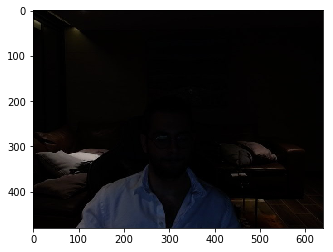

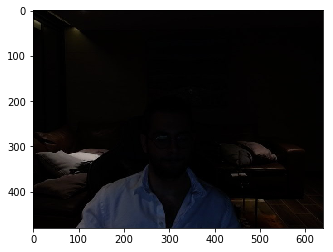

True


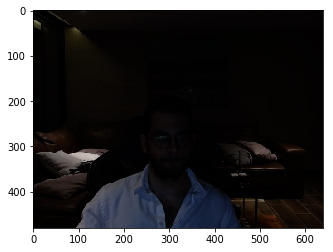

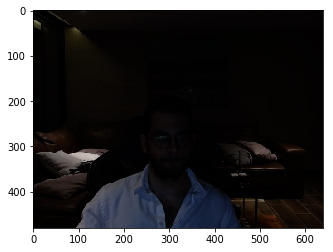

True


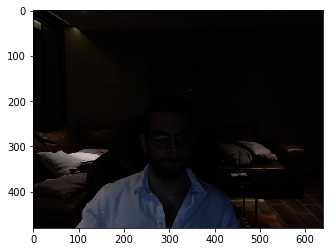

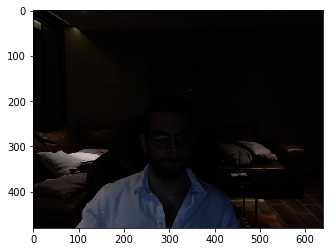

True


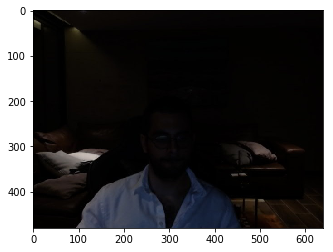

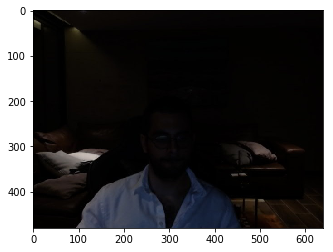

True
[228.04985046 248.61484528 364.33364868 349.86225128]


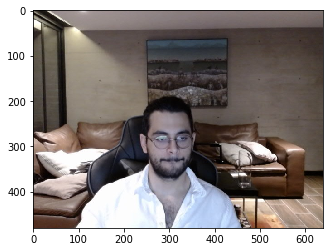

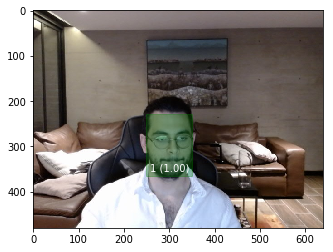

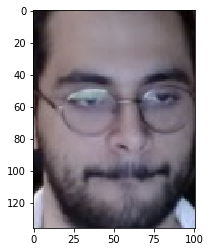

True
[230.46097755 246.85188293 360.36480904 348.98952484]


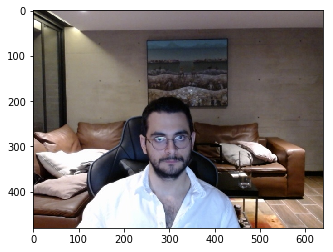

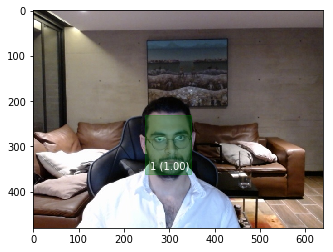

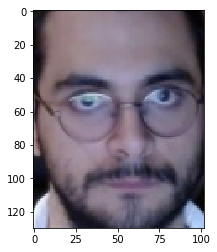

True
[231.25844479 247.71263123 361.33203506 348.95366669]


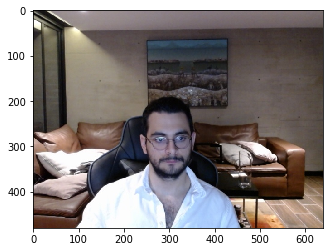

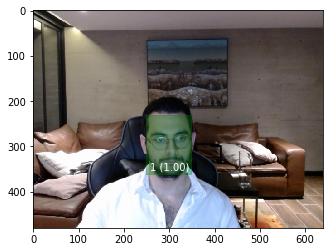

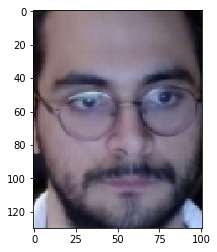

True
[231.71064377 248.13251495 362.29660034 349.31720734]


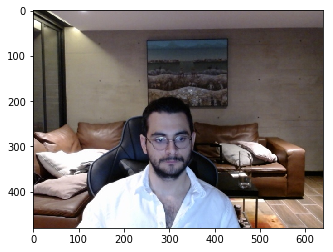

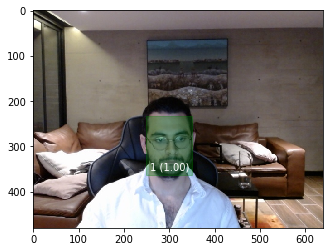

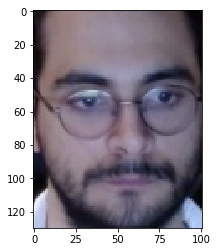

True
[230.8389473  248.2542038  361.65739059 348.9238739 ]


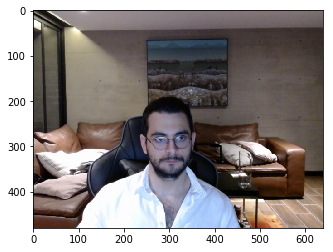

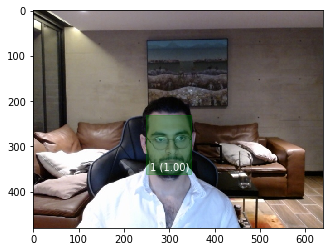

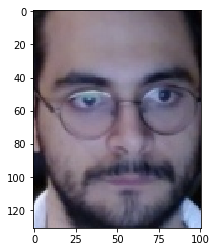

True
[239.27863598 247.70370483 363.73455048 350.76999664]


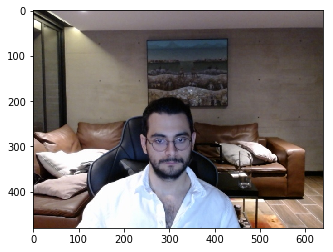

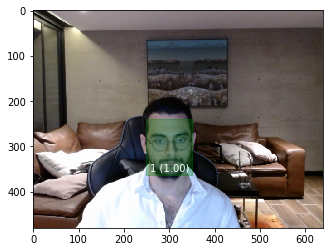

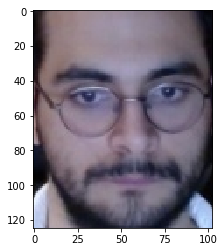

True
[236.20485306 245.92155457 364.08239365 350.48202515]


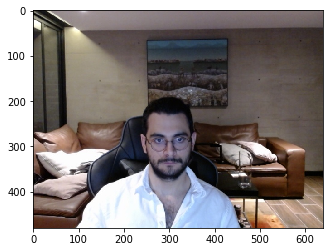

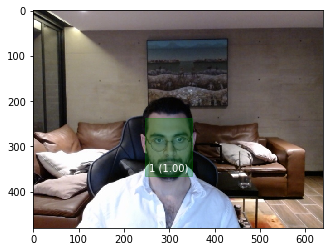

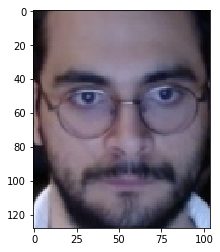

True
[240.09149551 246.8910408  365.76078415 350.25081635]


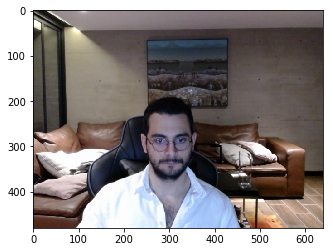

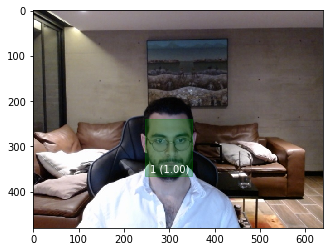

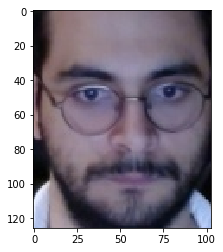

True
[237.65413284 247.71770477 364.4201088  350.91270447]


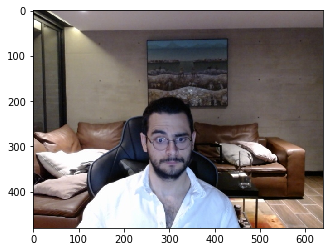

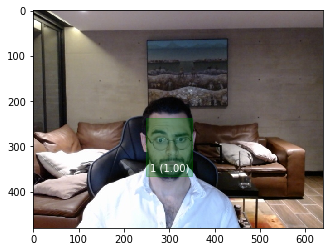

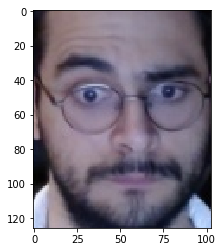

True
[237.44527817 247.97325134 364.40168381 351.03397369]


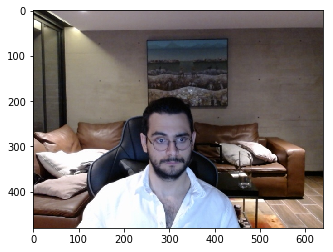

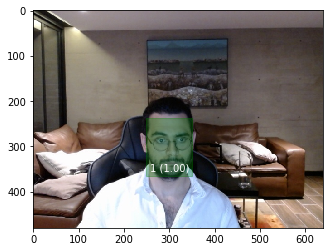

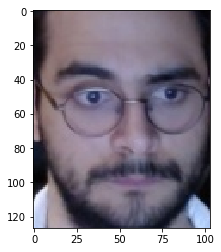

True
[230.91962814 246.43619537 363.63899231 348.40400696]


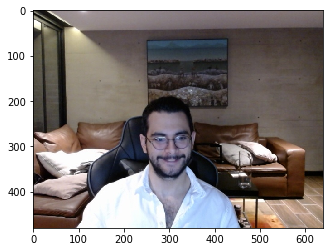

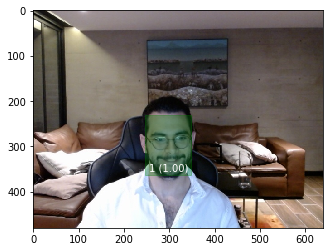

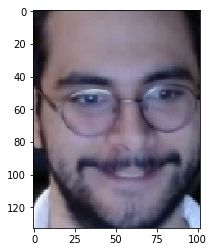

True
[222.75375366 244.60632324 358.84735107 346.34750366]


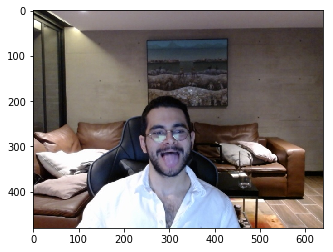

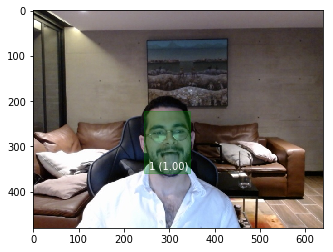

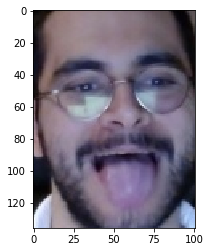

True
[227.53798485 246.51678085 359.20008659 345.33004761]


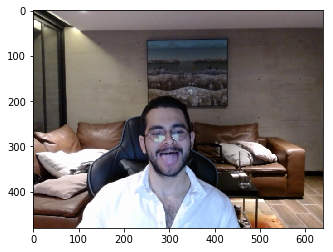

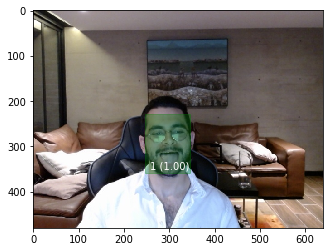

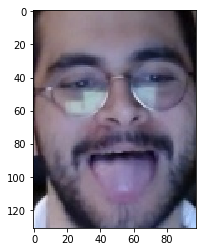

True
[225.82134247 246.32232666 358.78692627 345.41862488]


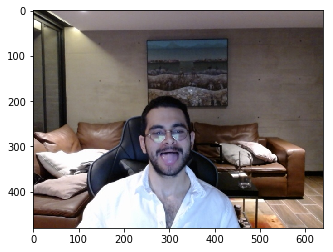

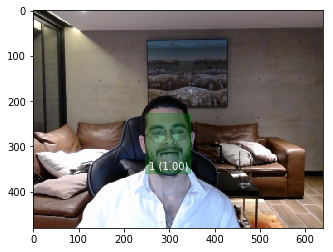

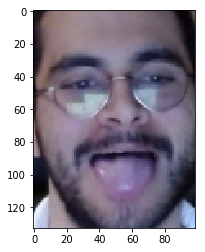

True
[228.78622055 246.09237671 359.01866913 345.93173981]


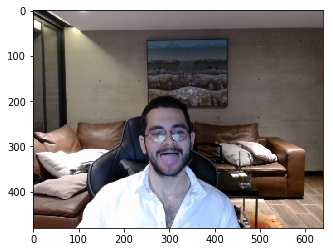

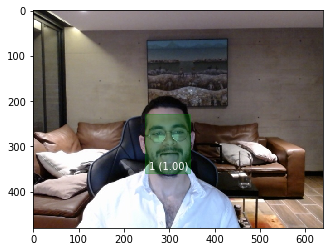

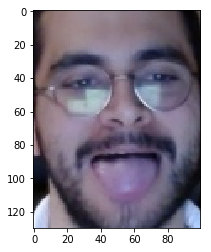

True
[227.94297695 246.12358093 358.37900162 345.96954346]


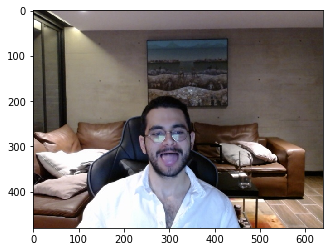

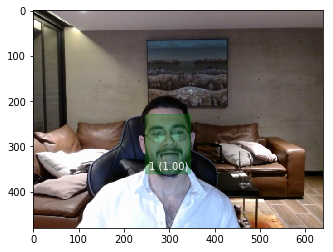

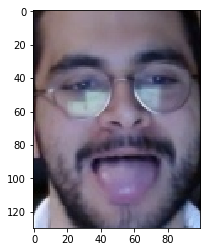

True
[228.57081413 245.72387695 357.1114254  346.56082153]


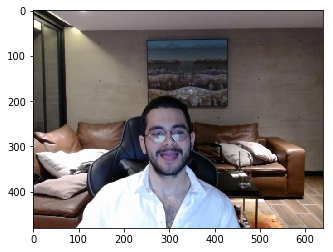

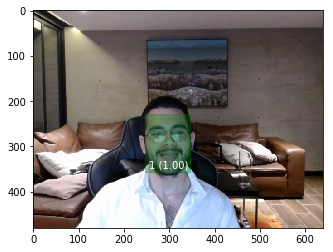

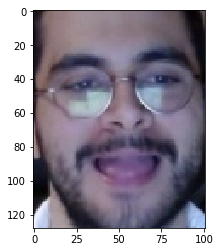

True
[228.04690361 246.59557343 359.47571754 346.820755  ]


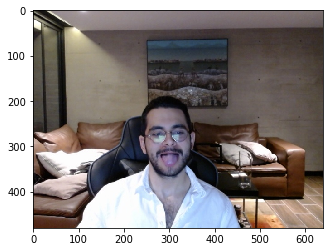

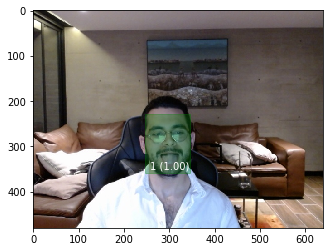

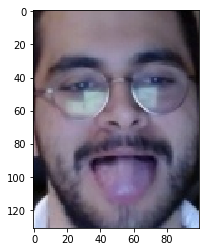

True
[225.69766045 245.40248871 360.78434944 348.72509003]


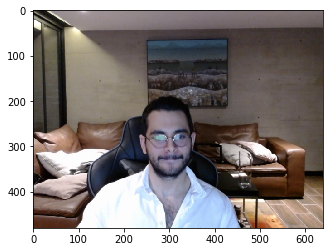

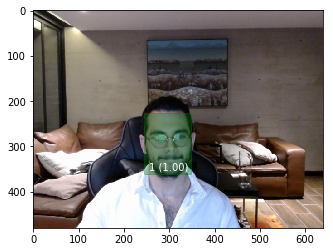

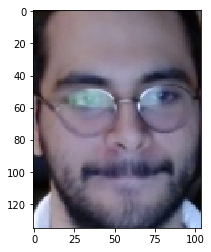

True
[227.88133621 246.67575836 354.44091797 348.9931488 ]


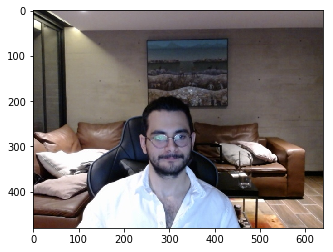

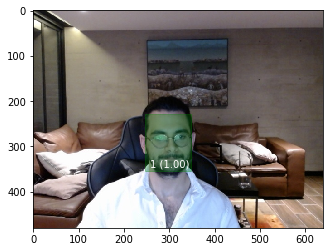

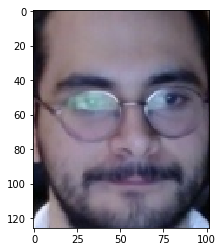

True
[229.19670582 247.14183807 356.47069931 348.94966125]


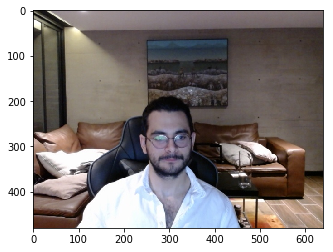

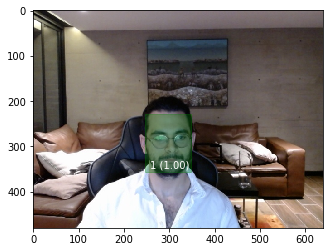

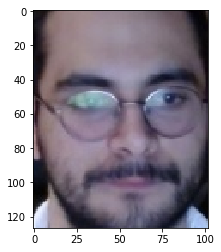

True
[228.47033501 247.13851929 355.9974575  348.88324738]


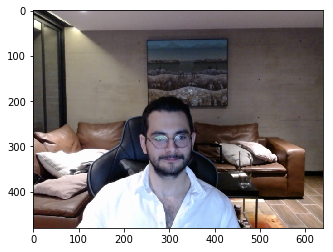

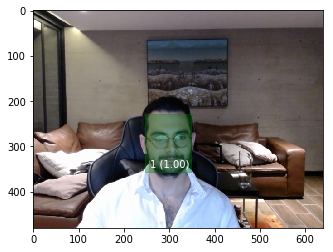

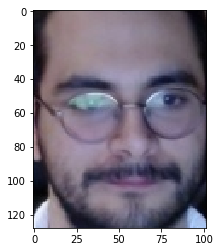

True
[228.56665134 247.28681564 356.87038422 348.87397766]


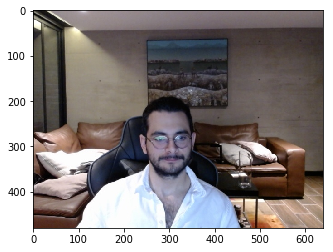

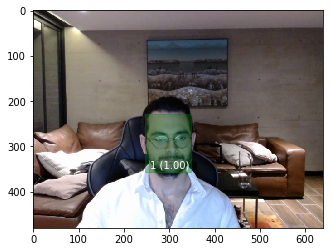

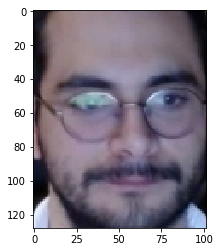

True
[227.95113087 247.03586578 356.5545845  348.86787415]


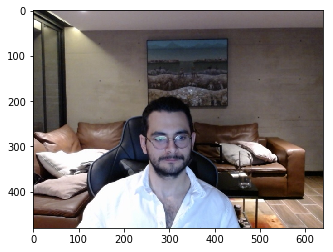

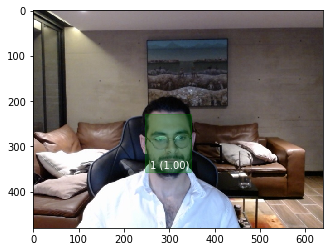

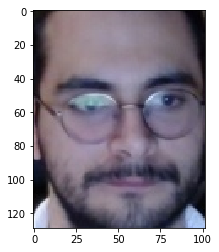

True
[229.08983231 246.37542725 356.87484741 348.7720108 ]


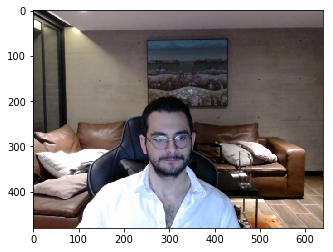

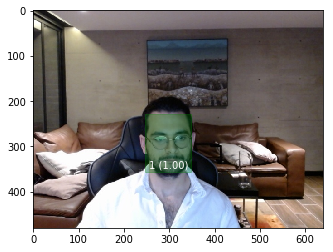

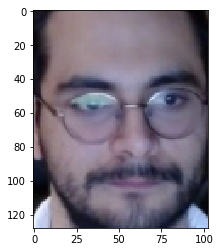

True
[228.36128712 246.99083328 357.21364975 348.72840881]


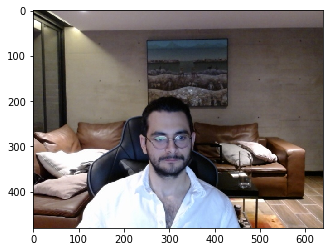

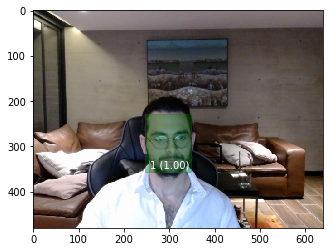

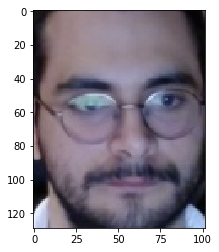

True
[226.79027081 244.27974701 355.93986511 348.1105423 ]


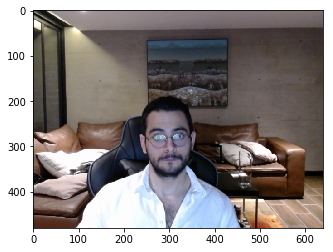

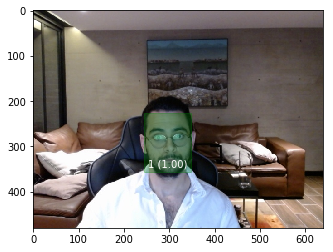

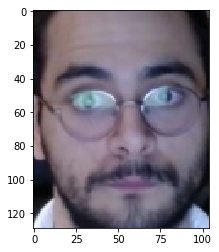

True
[228.64816189 246.61809921 359.57897186 348.59260559]


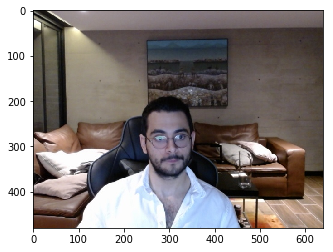

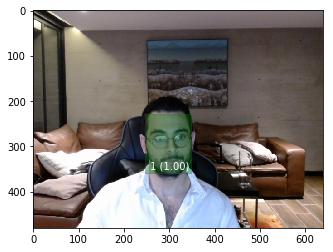

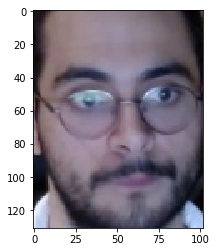

True
[227.16520786 245.23231506 351.28297806 348.50605011]


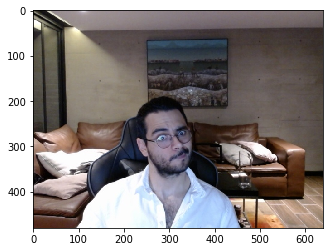

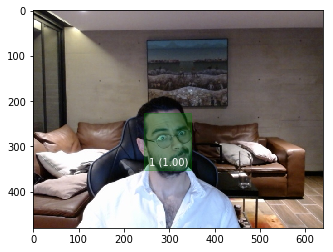

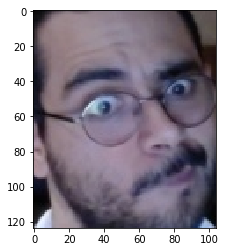

True
[229.02228355 245.30361176 352.12328911 347.73677826]


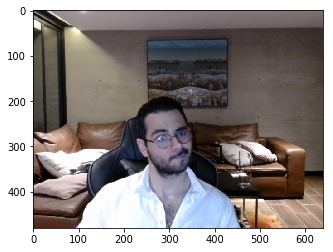

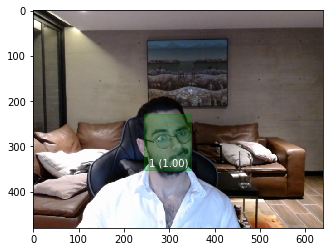

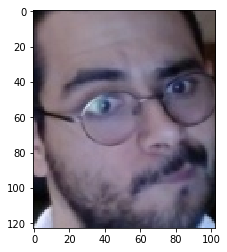

True
[229.87735748 245.17473221 351.32326126 349.02706146]


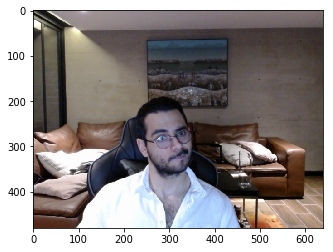

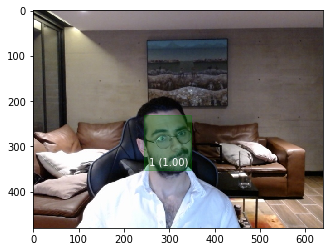

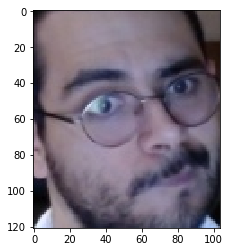

True
[229.54120159 245.08907318 352.69306183 348.89408112]


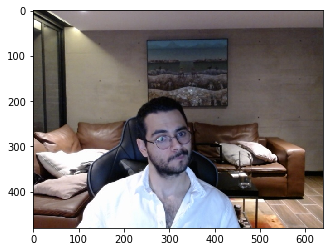

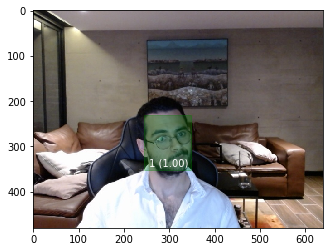

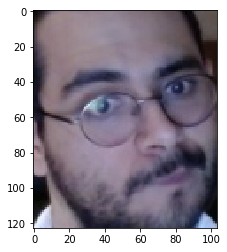

True
[230.98909378 244.39956665 353.34280014 348.79116058]


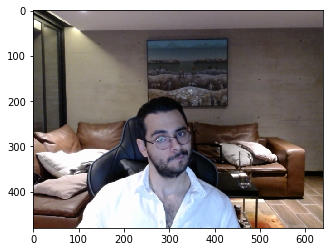

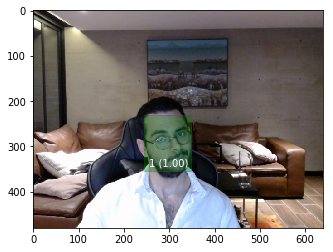

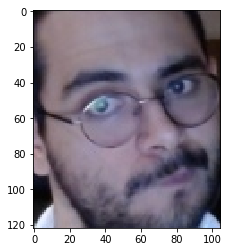

In [ ]:
LOCAL_MQTT_HOST="mosquitto"
LOCAL_MQTT_PORT=1883
LOCAL_MQTT_TOPIC="test_topic"

def on_connect_local(client, userdata, flags, rc):
        print("connected to local broker with rc: " + str(rc))
        client.subscribe(LOCAL_MQTT_TOPIC)

def on_message(client,userdata, msg):
  try:
    print("message received!")
    # if we wanted to re-publish this message, something like this should work
    # msg = msg.payload
    # remote_mqttclient.publish(REMOTE_MQTT_TOPIC, payload=msg, qos=0, retain=False)
  except:
    print("Unexpected error:", sys.exc_info()[0])

local_mqttclient = mqtt.Client()
local_mqttclient.on_connect = on_connect_local
local_mqttclient.connect(LOCAL_MQTT_HOST, LOCAL_MQTT_PORT, 60)
local_mqttclient.on_message = on_message
# 1 should correspond to /dev/video1 , your USB camera. The 0 is reserved for the TX2 onboard camera
cap = cv2.VideoCapture(1)
count = 0
while(True):
    ret, frame = cap.read()
    #frame = cv2.imwrite("frame.png", frame)
    # We don't use the color information, so might as well save space
    gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
    print( count == count+0)
    rc,png = cv2.imencode('.jpg', frame)

    #msg = png.tobytes()
    #with open('test.bin','a+') as f:
    #    f.write(msg)
    #cv2.imshow('cnts',sub_face)
    #cv2.waitKey(0)
    count = count +1
    with open('picture_out.jpg', 'wb') as f:
        f.write(png)
    IMAGE_PATH = 'picture_out.jpg'
    time.sleep(1)
    image = Image.open(IMAGE_PATH)
    plt.imshow(image)
    output_dir=''
    frozen_graph = tf.GraphDef()
    with open(os.path.join(output_dir, FROZEN_GRAPH_NAME), 'rb') as f:
        frozen_graph.ParseFromString(f.read())

    # https://github.com/NVIDIA-AI-IOT/tf_trt_models/blob/master/tf_trt_models/detection.py
    INPUT_NAME='image_tensor'
    BOXES_NAME='detection_boxes'
    CLASSES_NAME='detection_classes'
    SCORES_NAME='detection_scores'
    MASKS_NAME='detection_masks'
    NUM_DETECTIONS_NAME='num_detections'

    input_names = [INPUT_NAME]
    output_names = [BOXES_NAME, CLASSES_NAME, SCORES_NAME, NUM_DETECTIONS_NAME]

    image = Image.open(IMAGE_PATH)

    plt.imshow(image)

    image_resized = np.array(image.resize((300, 300)))
    image = np.array(image)
    scores, boxes, classes, num_detections = tf_sess.run([tf_scores, tf_boxes, tf_classes, tf_num_detections], feed_dict={tf_input: image_resized[None, ...]})
    boxes = boxes[0] # index by 0 to remove batch dimension
    scores = scores[0]
    classes = classes[0]
    num_detections = num_detections[0]

    # suppress boxes that are below the threshold.. 
    DETECTION_THRESHOLD = 0.5

    fig = plt.figure()
    ax = fig.add_subplot(1, 1, 1)

    ax.imshow(image)
    box = 'hola'
    # plot boxes exceeding score threshold
    for i in range(int(num_detections)):
        if scores[i] < DETECTION_THRESHOLD:
            continue
        # scale box to image coordinates
        box = boxes[i] * np.array([image.shape[0], image.shape[1], image.shape[0], image.shape[1]])
    #     print(i)
        print(box)
        # display rectangle
        patch = patches.Rectangle((box[1], box[0]), box[3] - box[1], box[2] - box[0], color='g', alpha=0.3)
        ax.add_patch(patch)

        # display class index and score
        plt.text(x=box[1] + 10, y=box[2] - 10, s='%d (%0.2f) ' % (classes[i], scores[i]), color='w')

    plt.show()
    #print(box)
    if (type(box) == str):
        continue
    else:
        im = Image.open('picture_out.jpg')
        im_crop = im.crop((box[1], box[0], box[3], box[2]))
        im_crop.save('picture_out'+str(count)+str(count)+'.jpg', quality=95)

        fig = plt.figure()
        ax = fig.add_subplot(1, 1, 1)

        ax.imshow(im_crop)

        plt.show()
        image = cv2.imread('picture_out'+str(count)+str(count)+'.jpg')
        #msg = image.tobytes()
        with open('picture_out'+str(count)+str(count)+'.jpg', "rb") as image:
            b64string = base64.b64encode(image.read()) 
        local_mqttclient.publish(LOCAL_MQTT_TOPIC,payload=b64string)
cap.release()

# TEST CODE

In [85]:
import numpy as np
import cv2

# 1 should correspond to /dev/video1 , your USB camera. The 0 is reserved for the TX2 onboard camera
cap = cv2.VideoCapture(1)
count = 0
while(True):
    # Capture frame-by-frame
    ret, frame = cap.read()
    #frame = cv2.imwrite("frame.png", frame)
    # We don't use the color information, so might as well save space
    gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
    # face detection and other logic goes here
    face_cascade = cv2.CascadeClassifier('/notebooks/tf_trt_models/examples/classificatio/data/haarcascade_frontalface_default.xml')
    #gray = cv2.cvtColor(gray, cv2.COLOR_BGR2GRAY)
    print(face_cascade.load('haarcascade_frontalface_default.xml'))
    # gray here is the gray frame you will be getting from a camera
    faces = face_cascade.detectMultiScale(gray, 1.3, 5)
    if np.any(faces):
        for (x,y,w,h) in faces:
	    # your logic goes here; for instance
	    # cut out face from the frame..
            #pt1 = (int(x), int(y))
            #pt2 = (int((x + w)), int((y + h)))
            face_region = cv2.rectangle(gray,(x,y),(x+w,y+h),(255,0,0),2)
            sub_face = gray[y:y+h, x:x+w]
            #roi_gray = gray[y:y+h, x:x+w]
	    # rc,png = cv2.imencode('.png', face)
	    # msg = png.tobytes()
            if np.any(face_region):
                count = count +1
                rc,png = cv2.imencode('.jpg', sub_face)

                #msg = png.tobytes()
                #with open('test.bin','a+') as f:
                #    f.write(msg)
                #cv2.imshow('cnts',sub_face)
                #cv2.waitKey(0)
                
                with open('picture_out'+str(count)+'.jpg', 'wb') as f:
                    f.write(png)
cap.release()
#cv2.destroyAllWindows()

ImportError: /usr/lib/aarch64-linux-gnu/libgomp.so.1: cannot allocate memory in static TLS block

In [ ]:
import numpy as np
import cv2

# 1 should correspond to /dev/video1 , your USB camera. The 0 is reserved for the TX2 onboard camera
cap = cv2.VideoCapture(1)
count = 0
while(True):
    # Capture frame-by-frame
    ret, frame = cap.read()
    #frame = cv2.imwrite("frame.png", frame)
    # We don't use the color information, so might as well save space
    gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
    # face detection and other logic goes here
    face_cascade = cv2.CascadeClassifier('/notebooks/tf_trt_models/examples/classificatio/data/haarcascade_frontalface_default.xml')
    #gray = cv2.cvtColor(gray, cv2.COLOR_BGR2GRAY)
    print(face_cascade.load('haarcascade_frontalface_default.xml'))
    
    rc,png = cv2.imencode('.jpg', gray)

    #msg = png.tobytes()
    #with open('test.bin','a+') as f:
    #    f.write(msg)
    #cv2.imshow('cnts',sub_face)
    #cv2.waitKey(0)
    count = count +1
    with open('picture_out.jpg', 'wb') as f:
        f.write(png)
cap.release()

True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True


In [9]:
count = 1
print( count == count+0)
import time

True


In [7]:
import numpy as np
import cv2
from PIL import Image
import sys
import os
import urllib
import tensorflow.contrib.tensorrt as trt
import matplotlib
matplotlib.use('Agg')
import matplotlib.pyplot as plt
import matplotlib.patches as patches
import tensorflow as tf
import numpy as np
import time
from tf_trt_models.detection import download_detection_model, build_detection_graph
import time
#time.sleep(3)

%matplotlib inline
FROZEN_GRAPH_NAME = 'data/frozen_inference_graph_face.pb'
!wget https://github.com/yeephycho/tensorflow-face-detection/blob/master/model/frozen_inference_graph_face.pb?raw=true -O {FROZEN_GRAPH_NAME}

IMAGE_PATH = 'Andres.jpg'
    
output_dir=''
frozen_graph = tf.GraphDef()
with open(os.path.join(output_dir, FROZEN_GRAPH_NAME), 'rb') as f:
    frozen_graph.ParseFromString(f.read())
    
# https://github.com/NVIDIA-AI-IOT/tf_trt_models/blob/master/tf_trt_models/detection.py
INPUT_NAME='image_tensor'
BOXES_NAME='detection_boxes'
CLASSES_NAME='detection_classes'
SCORES_NAME='detection_scores'
MASKS_NAME='detection_masks'
NUM_DETECTIONS_NAME='num_detections'

input_names = [INPUT_NAME]
output_names = [BOXES_NAME, CLASSES_NAME, SCORES_NAME, NUM_DETECTIONS_NAME]
#ESTE
trt_graph = trt.create_inference_graph(
    input_graph_def=frozen_graph,
    outputs=output_names,
    max_batch_size=1,
    max_workspace_size_bytes=1 << 25,
    precision_mode='FP16',
    minimum_segment_size=50
)
#Y este
tf_config = tf.ConfigProto()
tf_config.gpu_options.allow_growth = True

tf_sess = tf.Session(config=tf_config)

# use this if you want to try on the optimized TensorRT graph
# Note that this will take a while
# tf.import_graph_def(trt_graph, name='')

# use this if you want to try directly on the frozen TF graph
# this is much faster
tf.import_graph_def(frozen_graph, name='')

tf_input = tf_sess.graph.get_tensor_by_name(input_names[0] + ':0')
tf_scores = tf_sess.graph.get_tensor_by_name('detection_scores:0')
tf_boxes = tf_sess.graph.get_tensor_by_name('detection_boxes:0')
tf_classes = tf_sess.graph.get_tensor_by_name('detection_classes:0')
tf_num_detections = tf_sess.graph.get_tensor_by_name('num_detections:0')

The TensorFlow contrib module will not be included in TensorFlow 2.0.
For more information, please see:
  * https://github.com/tensorflow/community/blob/master/rfcs/20180907-contrib-sunset.md
  * https://github.com/tensorflow/addons
  * https://github.com/tensorflow/io (for I/O related ops)
If you depend on functionality not listed there, please file an issue.



--2020-07-11 17:19:02--  https://github.com/yeephycho/tensorflow-face-detection/blob/master/model/frozen_inference_graph_face.pb?raw=true
Resolving github.com (github.com)... 140.82.112.3
Connecting to github.com (github.com)|140.82.112.3|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://github.com/yeephycho/tensorflow-face-detection/raw/master/model/frozen_inference_graph_face.pb [following]
--2020-07-11 17:19:02--  https://github.com/yeephycho/tensorflow-face-detection/raw/master/model/frozen_inference_graph_face.pb
Reusing existing connection to github.com:443.
HTTP request sent, awaitin

True
[226.90448284 229.88956451 372.54112244 340.34496307]


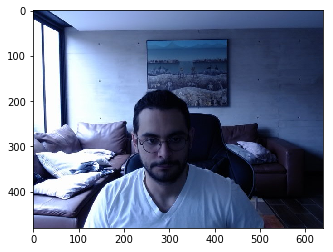

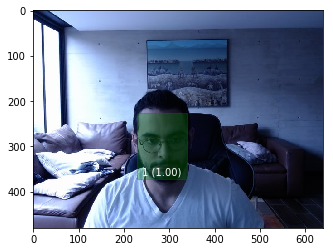

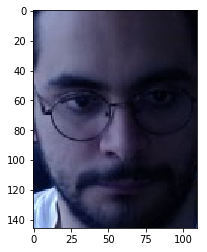

True
[228.77580643 229.94903564 371.42784119 341.49341583]


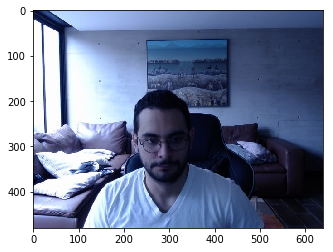

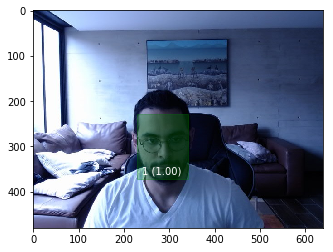

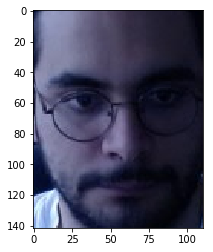

True
[227.8896904  231.28385544 370.97940445 342.08183289]


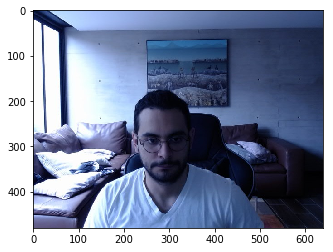

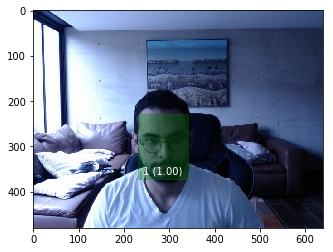

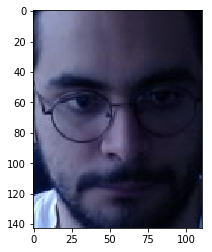

True
[226.44114017 230.98987579 372.89205551 342.7230072 ]


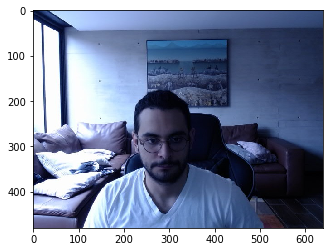

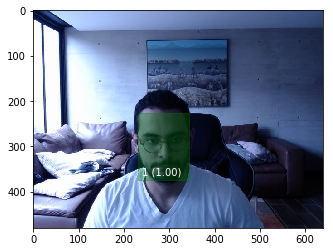

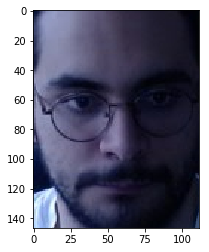

True
[227.0990181  231.19163513 373.63088608 343.1350708 ]


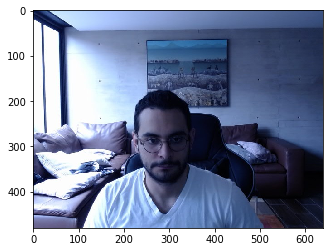

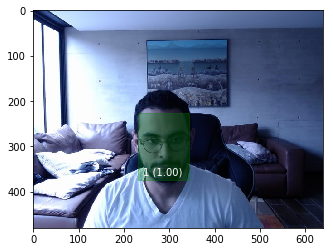

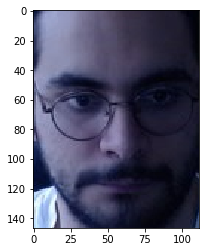

True
[227.63235569 241.03309631 369.14960861 351.41281128]


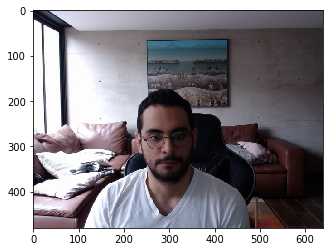

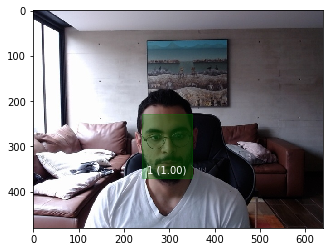

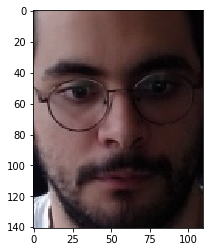

True
[227.56035805 243.248806   365.50835609 352.84233093]


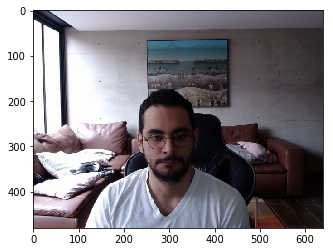

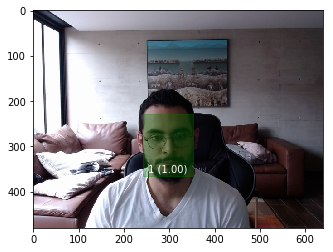

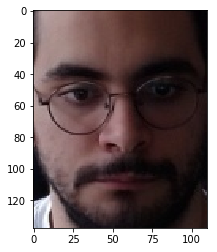

True
[224.7231245  240.64008713 368.1303978  352.63305664]


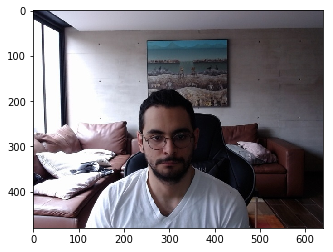

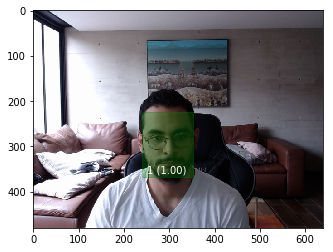

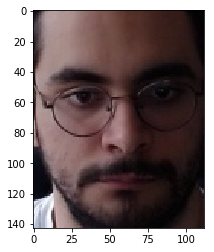

True
[226.49198055 241.44226074 365.56692123 354.51351166]


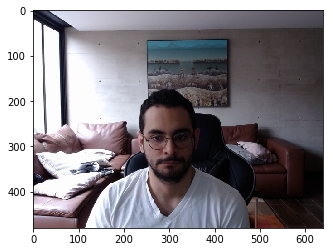

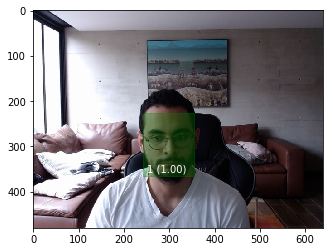

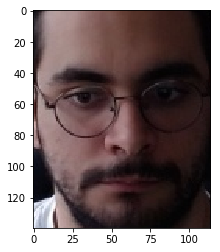

True
[221.28996849 238.55340958 342.92246819 347.65281677]


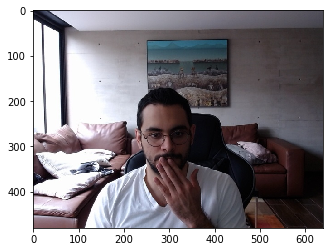

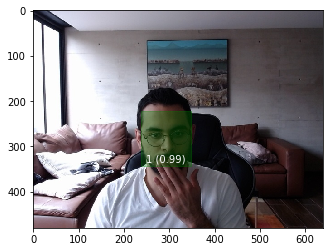

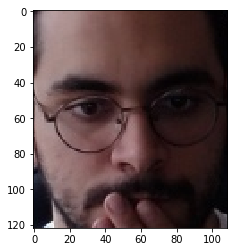

True


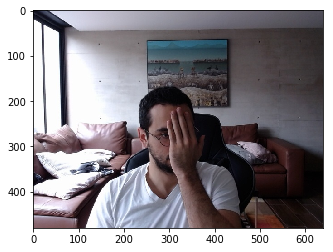

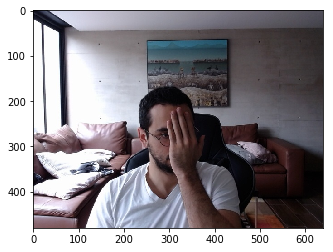

True


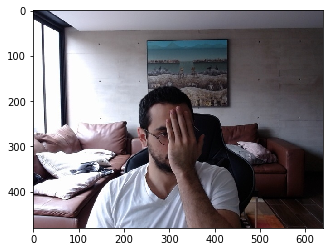

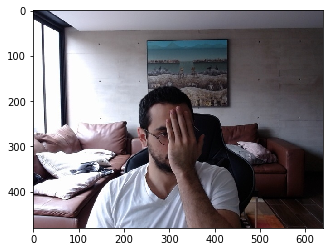

True


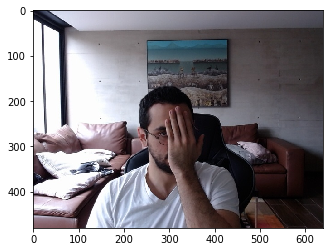

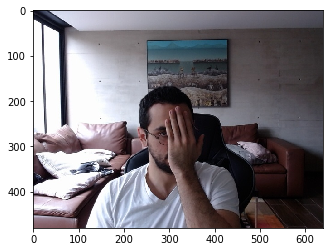

True


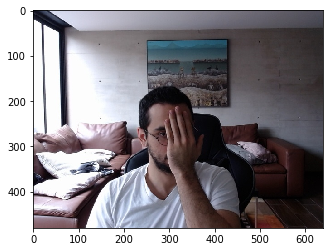

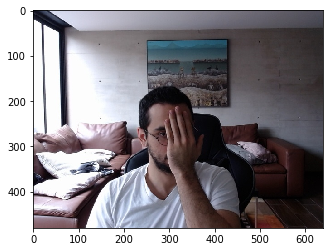

True
[219.47609425 250.67590714 330.69437027 332.29522705]


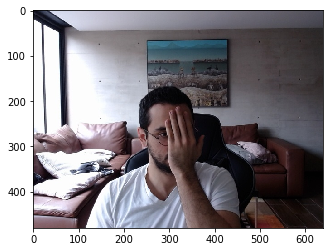

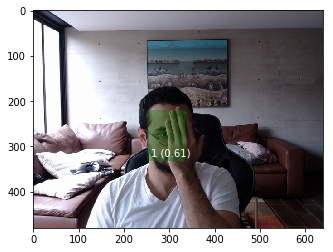

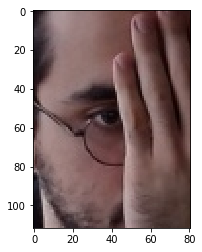

True
[220.38446903 249.85620499 331.13754272 331.30615234]


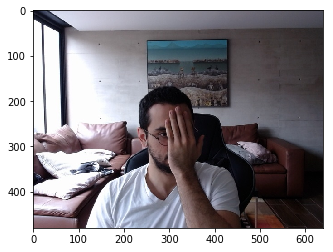

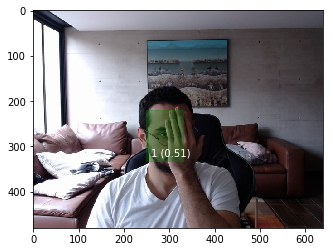

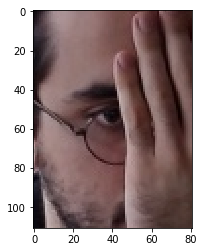

True
[222.17861652 249.47776794 334.69408035 336.18831635]


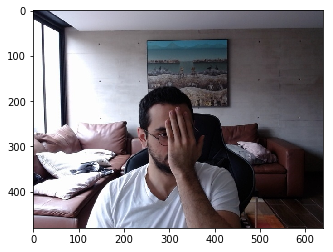

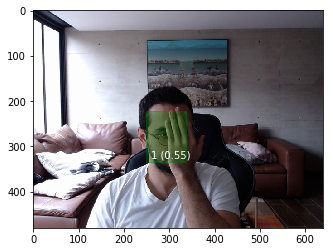

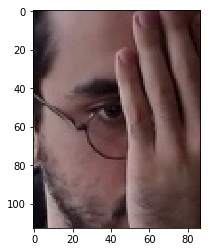

True


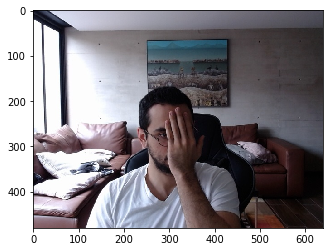

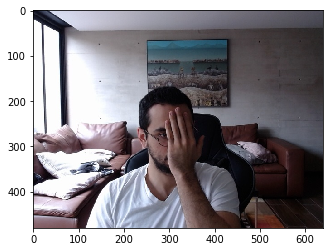

True


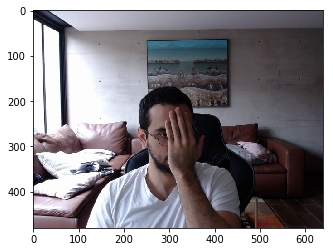

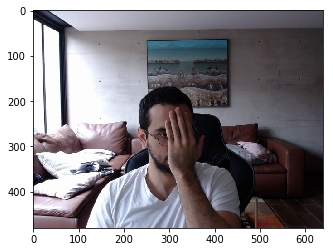

True
[221.55946255 250.65824509 331.21390343 336.15936279]


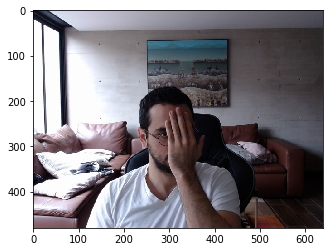

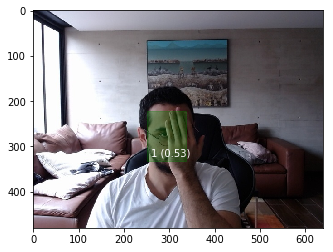

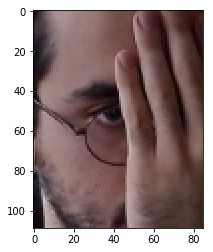

True


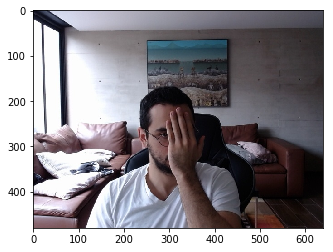

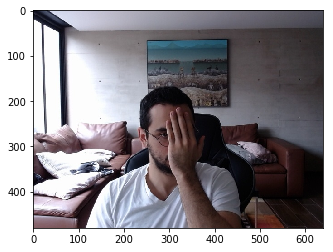

True
[222.0512867  240.66110611 351.60618782 345.26023865]


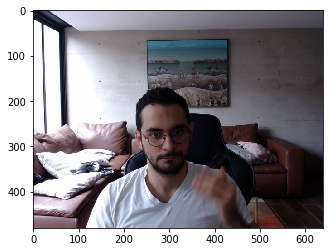

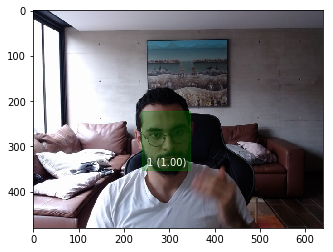

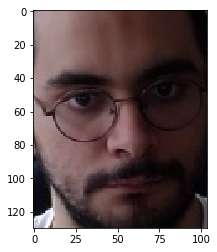

True
[226.33551121 240.0345993  370.61067581 355.25997162]


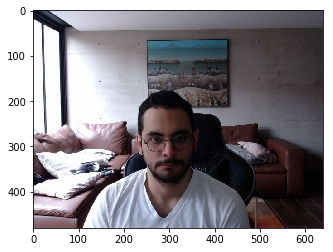

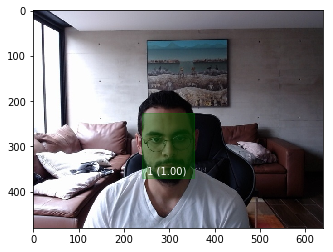

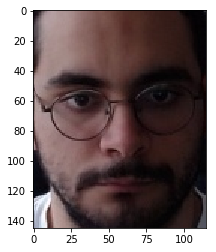

True
[227.68115044 240.73921204 370.36414146 353.11733246]


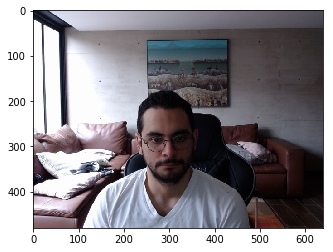

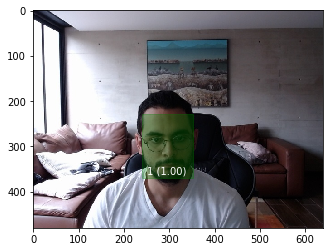

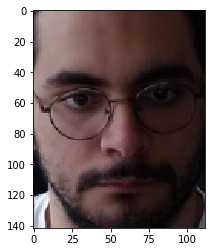

True
[232.02554226 240.01878738 366.65468216 353.45329285]


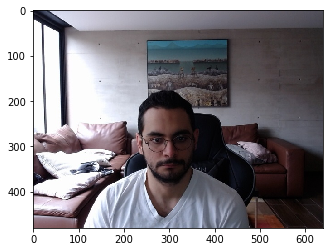

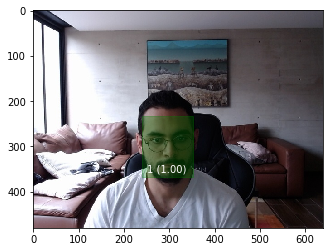

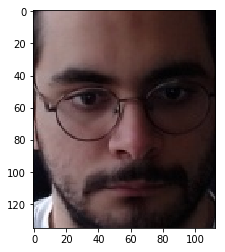

True
[230.52168846 239.33952332 366.10133171 354.48883057]


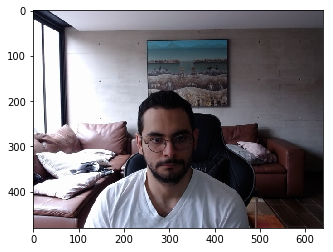

In [ ]:

# 1 should correspond to /dev/video1 , your USB camera. The 0 is reserved for the TX2 onboard camera
cap = cv2.VideoCapture(1)
count = 0
while(True):
    ret, frame = cap.read()
    #frame = cv2.imwrite("frame.png", frame)
    # We don't use the color information, so might as well save space
    gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
    print( count == count+0)
    rc,png = cv2.imencode('.jpg', frame)

    #msg = png.tobytes()
    #with open('test.bin','a+') as f:
    #    f.write(msg)
    #cv2.imshow('cnts',sub_face)
    #cv2.waitKey(0)
    count = count +1
    with open('picture_out.jpg', 'wb') as f:
        f.write(png)
    IMAGE_PATH = 'picture_out.jpg'
    time.sleep(1)
    image = Image.open(IMAGE_PATH)
    plt.imshow(image)
    output_dir=''
    frozen_graph = tf.GraphDef()
    with open(os.path.join(output_dir, FROZEN_GRAPH_NAME), 'rb') as f:
        frozen_graph.ParseFromString(f.read())

    # https://github.com/NVIDIA-AI-IOT/tf_trt_models/blob/master/tf_trt_models/detection.py
    INPUT_NAME='image_tensor'
    BOXES_NAME='detection_boxes'
    CLASSES_NAME='detection_classes'
    SCORES_NAME='detection_scores'
    MASKS_NAME='detection_masks'
    NUM_DETECTIONS_NAME='num_detections'

    input_names = [INPUT_NAME]
    output_names = [BOXES_NAME, CLASSES_NAME, SCORES_NAME, NUM_DETECTIONS_NAME]

    image = Image.open(IMAGE_PATH)

    plt.imshow(image)

    image_resized = np.array(image.resize((300, 300)))
    image = np.array(image)
    scores, boxes, classes, num_detections = tf_sess.run([tf_scores, tf_boxes, tf_classes, tf_num_detections], feed_dict={tf_input: image_resized[None, ...]})
    boxes = boxes[0] # index by 0 to remove batch dimension
    scores = scores[0]
    classes = classes[0]
    num_detections = num_detections[0]

    # suppress boxes that are below the threshold.. 
    DETECTION_THRESHOLD = 0.5

    fig = plt.figure()
    ax = fig.add_subplot(1, 1, 1)

    ax.imshow(image)
    box = 'hola'
    # plot boxes exceeding score threshold
    for i in range(int(num_detections)):
        if scores[i] < DETECTION_THRESHOLD:
            continue
        # scale box to image coordinates
        box = boxes[i] * np.array([image.shape[0], image.shape[1], image.shape[0], image.shape[1]])
    #     print(i)
        print(box)
        # display rectangle
        patch = patches.Rectangle((box[1], box[0]), box[3] - box[1], box[2] - box[0], color='g', alpha=0.3)
        ax.add_patch(patch)

        # display class index and score
        plt.text(x=box[1] + 10, y=box[2] - 10, s='%d (%0.2f) ' % (classes[i], scores[i]), color='w')

    plt.show()
    #print(box)
    if (type(box) == str):
        continue
    else:
        im = Image.open('picture_out.jpg')
        im_crop = im.crop((box[1], box[0], box[3], box[2]))
        im_crop.save('picture_out'+str(count)+str(count)+'.jpg', quality=95)

        fig = plt.figure()
        ax = fig.add_subplot(1, 1, 1)

        ax.imshow(im_crop)

        plt.show()
cap.release()
#cv2.destroyAllWindows()

In [71]:
from PIL import Image
import sys
import os
import urllib
import tensorflow.contrib.tensorrt as trt
import matplotlib
matplotlib.use('Agg')
import matplotlib.pyplot as plt
import matplotlib.patches as patches
import tensorflow as tf
import numpy as np
import time
from tf_trt_models.detection import download_detection_model, build_detection_graph

%matplotlib inline
FROZEN_GRAPH_NAME = 'data/frozen_inference_graph_face.pb'
!wget https://github.com/yeephycho/tensorflow-face-detection/blob/master/model/frozen_inference_graph_face.pb?raw=true -O {FROZEN_GRAPH_NAME}

IMAGE_PATH = 'Andres.jpg'
    
output_dir=''
frozen_graph = tf.GraphDef()
with open(os.path.join(output_dir, FROZEN_GRAPH_NAME), 'rb') as f:
    frozen_graph.ParseFromString(f.read())
    
# https://github.com/NVIDIA-AI-IOT/tf_trt_models/blob/master/tf_trt_models/detection.py
INPUT_NAME='image_tensor'
BOXES_NAME='detection_boxes'
CLASSES_NAME='detection_classes'
SCORES_NAME='detection_scores'
MASKS_NAME='detection_masks'
NUM_DETECTIONS_NAME='num_detections'

input_names = [INPUT_NAME]
output_names = [BOXES_NAME, CLASSES_NAME, SCORES_NAME, NUM_DETECTIONS_NAME]
#ESTE
trt_graph = trt.create_inference_graph(
    input_graph_def=frozen_graph,
    outputs=output_names,
    max_batch_size=1,
    max_workspace_size_bytes=1 << 25,
    precision_mode='FP16',
    minimum_segment_size=50
)
#Y este
tf_config = tf.ConfigProto()
tf_config.gpu_options.allow_growth = True

tf_sess = tf.Session(config=tf_config)

# use this if you want to try on the optimized TensorRT graph
# Note that this will take a while
# tf.import_graph_def(trt_graph, name='')

# use this if you want to try directly on the frozen TF graph
# this is much faster
tf.import_graph_def(frozen_graph, name='')

tf_input = tf_sess.graph.get_tensor_by_name(input_names[0] + ':0')
tf_scores = tf_sess.graph.get_tensor_by_name('detection_scores:0')
tf_boxes = tf_sess.graph.get_tensor_by_name('detection_boxes:0')
tf_classes = tf_sess.graph.get_tensor_by_name('detection_classes:0')
tf_num_detections = tf_sess.graph.get_tensor_by_name('num_detections:0')



/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:7: UserWarning: 
This call to matplotlib.use() has no effect because the backend has already
been chosen; matplotlib.use() must be called *before* pylab, matplotlib.pyplot,
or matplotlib.backends is imported for the first time.

The backend was *originally* set to 'module://ipykernel.pylab.backend_inline' by the following code:
  File "/usr/lib/python3.6/runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "/usr/lib/python3.6/runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "/usr/local/lib/python3.6/dist-packages/traitlets/config/application.py", line 664, in launch_instance
    app.start()
  File "/usr/local/lib/python3.6/dist-packages/ipykernel/kernelapp.py", line 583, in start
    self.io_loop.start()
  File "/usr/local/lib/python3.6/dist-packages/tornado/platf

--2020-07-10 04:00:55--  https://github.com/yeephycho/tensorflow-face-detection/blob/master/model/frozen_inference_graph_face.pb?raw=true
Resolving github.com (github.com)... 140.82.112.3
Connecting to github.com (github.com)|140.82.112.3|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://github.com/yeephycho/tensorflow-face-detection/raw/master/model/frozen_inference_graph_face.pb [following]
--2020-07-10 04:00:56--  https://github.com/yeephycho/tensorflow-face-detection/raw/master/model/frozen_inference_graph_face.pb
Reusing existing connection to github.com:443.
HTTP request sent, awaiting response... 302 Found
Location: https://raw.githubusercontent.com/yeephycho/tensorflow-face-detection/master/model/frozen_inference_graph_face.pb [following]
--2020-07-10 04:00:56--  https://raw.githubusercontent.com/yeephycho/tensorflow-face-detection/master/model/frozen_inference_graph_face.pb
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 

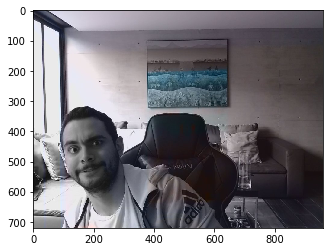

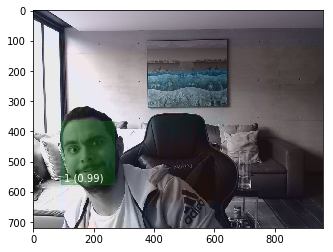

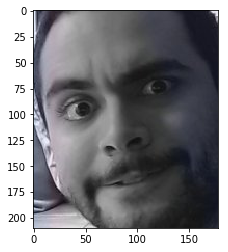

In [4]:
IMAGE_PATH = 'Andres3.jpg'
    
output_dir=''
frozen_graph = tf.GraphDef()
with open(os.path.join(output_dir, FROZEN_GRAPH_NAME), 'rb') as f:
    frozen_graph.ParseFromString(f.read())
    
# https://github.com/NVIDIA-AI-IOT/tf_trt_models/blob/master/tf_trt_models/detection.py
INPUT_NAME='image_tensor'
BOXES_NAME='detection_boxes'
CLASSES_NAME='detection_classes'
SCORES_NAME='detection_scores'
MASKS_NAME='detection_masks'
NUM_DETECTIONS_NAME='num_detections'

input_names = [INPUT_NAME]
output_names = [BOXES_NAME, CLASSES_NAME, SCORES_NAME, NUM_DETECTIONS_NAME]

image = Image.open(IMAGE_PATH)

plt.imshow(image)

image_resized = np.array(image.resize((300, 300)))
image = np.array(image)
scores, boxes, classes, num_detections = tf_sess.run([tf_scores, tf_boxes, tf_classes, tf_num_detections], feed_dict={
    tf_input: image_resized[None, ...]
})

boxes = boxes[0] # index by 0 to remove batch dimension
scores = scores[0]
classes = classes[0]
num_detections = num_detections[0]

# suppress boxes that are below the threshold.. 
DETECTION_THRESHOLD = 0.5

fig = plt.figure()
ax = fig.add_subplot(1, 1, 1)

ax.imshow(image)

# plot boxes exceeding score threshold
for i in range(int(num_detections)):
    if scores[i] < DETECTION_THRESHOLD:
        continue
    # scale box to image coordinates
    box = boxes[i] * np.array([image.shape[0], image.shape[1], image.shape[0], image.shape[1]])
#     print(i)
#     print(box)
    # display rectangle
    patch = patches.Rectangle((box[1], box[0]), box[3] - box[1], box[2] - box[0], color='g', alpha=0.3)
    ax.add_patch(patch)

    # display class index and score
    plt.text(x=box[1] + 10, y=box[2] - 10, s='%d (%0.2f) ' % (classes[i], scores[i]), color='w')

plt.show()

im = Image.open('Andres3.jpg')
im_crop = im.crop((box[1], box[0], box[3], box[2]))
im_crop.save('Andres4.jpg', quality=95)

fig = plt.figure()
ax = fig.add_subplot(1, 1, 1)

ax.imshow(im_crop)

plt.show()


In [7]:
box = 'hola'
if (type(box) == 4):
    print('hi')

hi


In [17]:
box = 'hola'
type(box) == str

True

# Scrap Code

In [ ]:
import numpy as np
import cv2

# 1 should correspond to /dev/video1 , your USB camera. The 0 is reserved for the TX2 onboard camera
cap = cv2.VideoCapture(1)
ret, frame = cap.read()
#gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
cv2.imshow('cnts',frame)

In [1]:
from PIL import Image
import sys
import os
import urllib
import tensorflow.contrib.tensorrt as trt
import matplotlib
matplotlib.use('Agg')
import matplotlib.pyplot as plt
import matplotlib.patches as patches
import tensorflow as tf
import numpy as np
import time
from tf_trt_models.detection import download_detection_model, build_detection_graph

%matplotlib inline
IMAGE_PATH = 'Andres.jpg'

The TensorFlow contrib module will not be included in TensorFlow 2.0.
For more information, please see:
  * https://github.com/tensorflow/community/blob/master/rfcs/20180907-contrib-sunset.md
  * https://github.com/tensorflow/addons
  * https://github.com/tensorflow/io (for I/O related ops)
If you depend on functionality not listed there, please file an issue.





In [47]:
FROZEN_GRAPH_NAME = 'data/frozen_inference_graph_face.pb'
!wget https://github.com/yeephycho/tensorflow-face-detection/blob/master/model/frozen_inference_graph_face.pb?raw=true -O {FROZEN_GRAPH_NAME}

--2020-07-10 02:59:01--  https://github.com/yeephycho/tensorflow-face-detection/blob/master/model/frozen_inference_graph_face.pb?raw=true
Resolving github.com (github.com)... 140.82.114.3
Connecting to github.com (github.com)|140.82.114.3|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://github.com/yeephycho/tensorflow-face-detection/raw/master/model/frozen_inference_graph_face.pb [following]
--2020-07-10 02:59:02--  https://github.com/yeephycho/tensorflow-face-detection/raw/master/model/frozen_inference_graph_face.pb
Reusing existing connection to github.com:443.
HTTP request sent, awaiting response... 302 Found
Location: https://raw.githubusercontent.com/yeephycho/tensorflow-face-detection/master/model/frozen_inference_graph_face.pb [following]
--2020-07-10 02:59:03--  https://raw.githubusercontent.com/yeephycho/tensorflow-face-detection/master/model/frozen_inference_graph_face.pb
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 

In [59]:
IMAGE_PATH = 'Andres.jpg'
#!wget 'https://cdn.vox-cdn.com/thumbor/rC0mlBATZdoDW1tEa44P6431sGc=/0x0:3683x2455/1200x800/filters:focal(1623x234:2211x822)/cdn.vox-cdn.com/uploads/chorus_image/image/63273148/usa_today_12005182.0.jpg' -O {IMAGE_PATH}

In [60]:
output_dir=''
frozen_graph = tf.GraphDef()
with open(os.path.join(output_dir, FROZEN_GRAPH_NAME), 'rb') as f:
  frozen_graph.ParseFromString(f.read())

In [61]:
# https://github.com/NVIDIA-AI-IOT/tf_trt_models/blob/master/tf_trt_models/detection.py
INPUT_NAME='image_tensor'
BOXES_NAME='detection_boxes'
CLASSES_NAME='detection_classes'
SCORES_NAME='detection_scores'
MASKS_NAME='detection_masks'
NUM_DETECTIONS_NAME='num_detections'

input_names = [INPUT_NAME]
output_names = [BOXES_NAME, CLASSES_NAME, SCORES_NAME, NUM_DETECTIONS_NAME]

In [51]:
#ESTE
trt_graph = trt.create_inference_graph(
    input_graph_def=frozen_graph,
    outputs=output_names,
    max_batch_size=1,
    max_workspace_size_bytes=1 << 25,
    precision_mode='FP16',
    minimum_segment_size=50
)

INFO:tensorflow:Linked TensorRT version: (6, 0, 1)
INFO:tensorflow:Loaded TensorRT version: (6, 0, 1)
INFO:tensorflow:Running against TensorRT version 6.0.1


In [52]:
#Y este
tf_config = tf.ConfigProto()
tf_config.gpu_options.allow_growth = True

tf_sess = tf.Session(config=tf_config)

# use this if you want to try on the optimized TensorRT graph
# Note that this will take a while
# tf.import_graph_def(trt_graph, name='')

# use this if you want to try directly on the frozen TF graph
# this is much faster
tf.import_graph_def(frozen_graph, name='')

tf_input = tf_sess.graph.get_tensor_by_name(input_names[0] + ':0')
tf_scores = tf_sess.graph.get_tensor_by_name('detection_scores:0')
tf_boxes = tf_sess.graph.get_tensor_by_name('detection_boxes:0')
tf_classes = tf_sess.graph.get_tensor_by_name('detection_classes:0')
tf_num_detections = tf_sess.graph.get_tensor_by_name('num_detections:0')

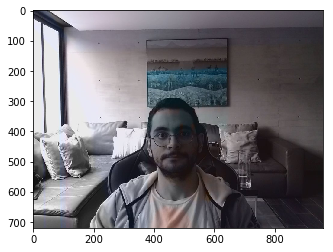

In [62]:

image = Image.open(IMAGE_PATH)

plt.imshow(image)

image_resized = np.array(image.resize((300, 300)))
image = np.array(image)

In [65]:
scores, boxes, classes, num_detections = tf_sess.run([tf_scores, tf_boxes, tf_classes, tf_num_detections], feed_dict={
    tf_input: image_resized[None, ...]
})

boxes = boxes[0] # index by 0 to remove batch dimension
scores = scores[0]
classes = classes[0]
num_detections = num_detections[0]

In [66]:

# suppress boxes that are below the threshold.. 
DETECTION_THRESHOLD = 0.5

0
[331.9382143  386.90039635 523.83718014 539.67956543]


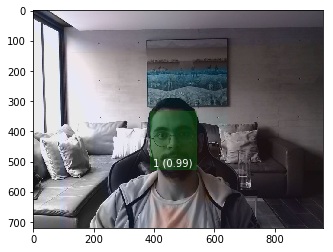

In [67]:
fig = plt.figure()
ax = fig.add_subplot(1, 1, 1)

ax.imshow(image)

# plot boxes exceeding score threshold
for i in range(int(num_detections)):
    if scores[i] < DETECTION_THRESHOLD:
        continue
    # scale box to image coordinates
    box = boxes[i] * np.array([image.shape[0], image.shape[1], image.shape[0], image.shape[1]])
    print(i)
    print(box)
    # display rectangle
    patch = patches.Rectangle((box[1], box[0]), box[3] - box[1], box[2] - box[0], color='g', alpha=0.3)
    ax.add_patch(patch)

    # display class index and score
    plt.text(x=box[1] + 10, y=box[2] - 10, s='%d (%0.2f) ' % (classes[i], scores[i]), color='w')

plt.show()

In [1]:
len(box)

NameError: name 'box' is not defined

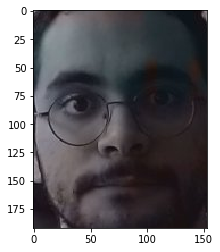

In [70]:
im = Image.open('Andres.jpg')
im_crop = im.crop((box[1], box[0], box[3], box[2]))
im_crop.save('Andres2.jpg', quality=95)

fig = plt.figure()
ax = fig.add_subplot(1, 1, 1)

ax.imshow(im_crop)

plt.show()

In [20]:
num_samples = 50

t0 = time.time()
for i in range(num_samples):
    scores, boxes, classes, num_detections = tf_sess.run([tf_scores, tf_boxes, tf_classes, tf_num_detections], feed_dict={
        tf_input: image_resized[None, ...]
    })
t1 = time.time()
print('Average runtime: %f seconds' % (float(t1 - t0) / num_samples))

Average runtime: 0.089058 seconds
